In [2]:
import torch
import torchvision
import os
import random
import flow_transforms_new
from presets import OpticalFlowPresetTrain, OpticalFlowPresetEval

In [2]:
class TSintel(torchvision.datasets.Sintel):
    def __init__(self, root):
        super().__init__(root=root)
        
    def __getitem__(self, index):
        img1, img2, flow = super().__getitem__(index)
        img1 = torchvision.transforms.ToTensor()(img1)
        img2 = torchvision.transforms.ToTensor()(img2)
        return img1, img2, flow

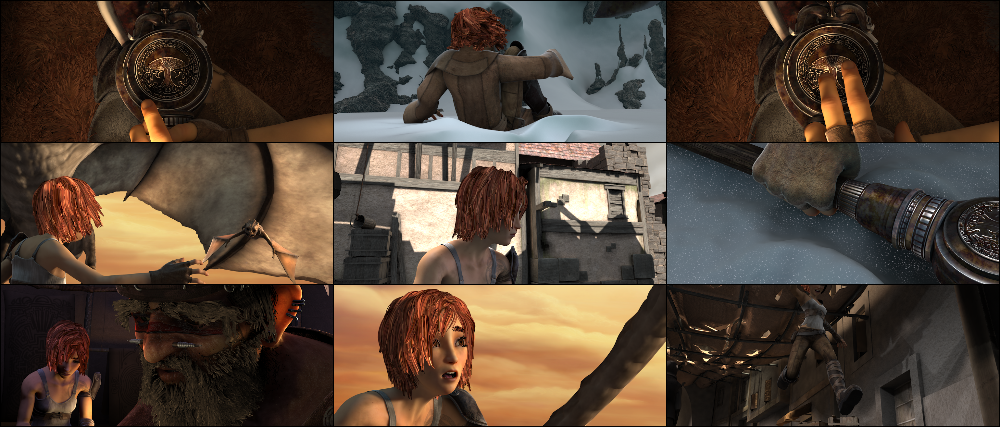

In [3]:
Tdata = TSintel(".")
indices = random.sample(range(1000), 9)
sampler = [Tdata[i][0] for i in indices]
grid = torchvision.utils.make_grid(sampler, nrow=3)
img = torchvision.transforms.ToPILImage()(grid)
img.show()

In [4]:
class TKitti(torchvision.datasets.KittiFlow):
    def __init__(self, root):
        super().__init__(root=root)
        
    def __getitem__(self, index):
        img1, img2, flow, valid_flow_mask = super().__getitem__(index)
        img1 = torchvision.transforms.ToTensor()(img1)
        img2 = torchvision.transforms.ToTensor()(img2)
        return img1, img2, flow, valid_flow_mask

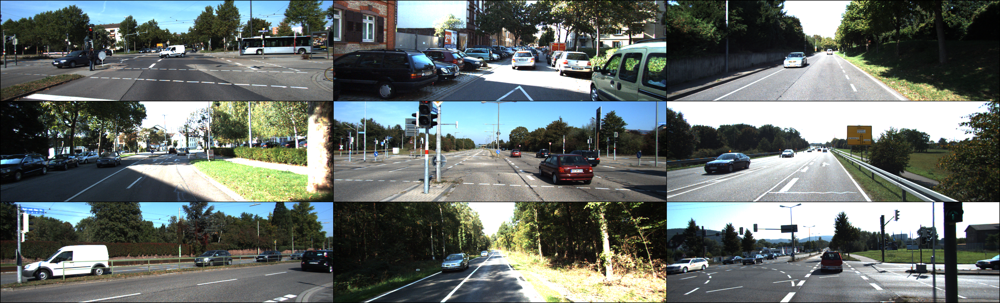

In [5]:
kitti = TKitti("./Kitti")
indices = random.sample(range(200), 9)
sampler = [torchvision.transforms.functional.crop(kitti[i][0], 0, 0, 375, 1241) for i in indices]
grid = torchvision.utils.make_grid(sampler, nrow=3)
img = torchvision.transforms.ToPILImage()(grid)
img.show()

In [3]:
class TFlyingChairs(torchvision.datasets.FlyingChairs):
    def __init__(self, root):
        super().__init__(root=root)
        
    def __getitem__(self, index):
        items = super().__getitem__(index)
        mask = None
        if len(items) == 4:
            img1, img2, flow, mask = final_transforms(items)
        else:
            img1, img2, flow = final_transforms(items)
        img1 = torchvision.transforms.ToTensor()(img1)
        img2 = torchvision.transforms.ToTensor()(img2)
        return img1, img2, flow, mask

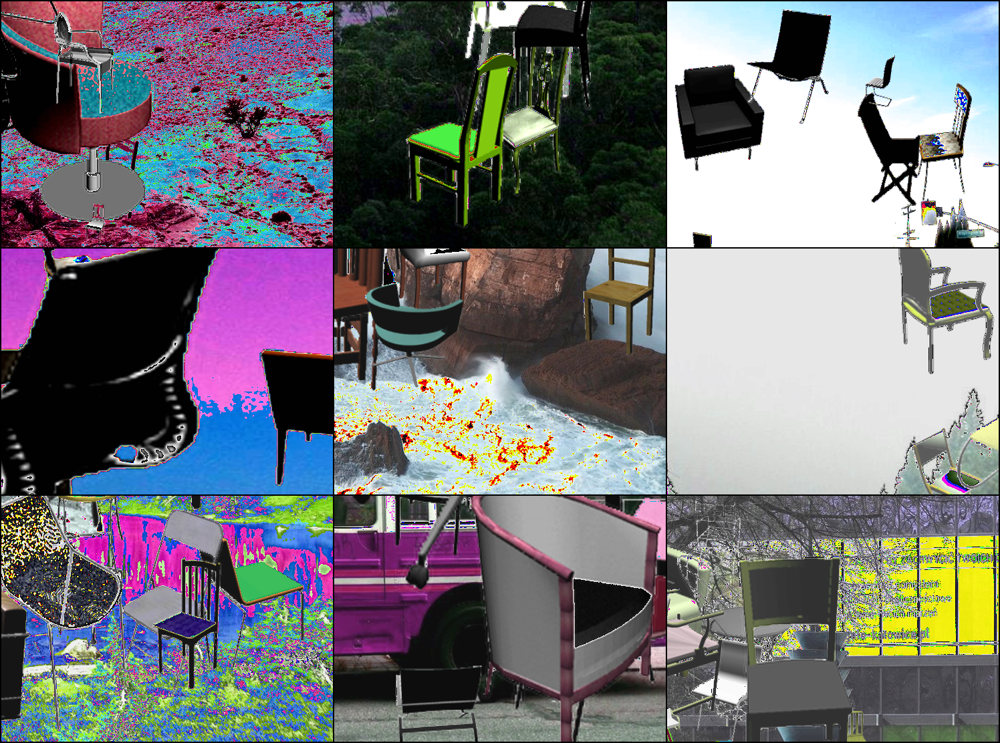

In [9]:
indices = random.sample(range(22000), 9)
sampler = [flyingChairs[i][0] for i in indices]
grid = torchvision.utils.make_grid(sampler, nrow=3)
img = torchvision.transforms.ToPILImage()(grid)
img.show()

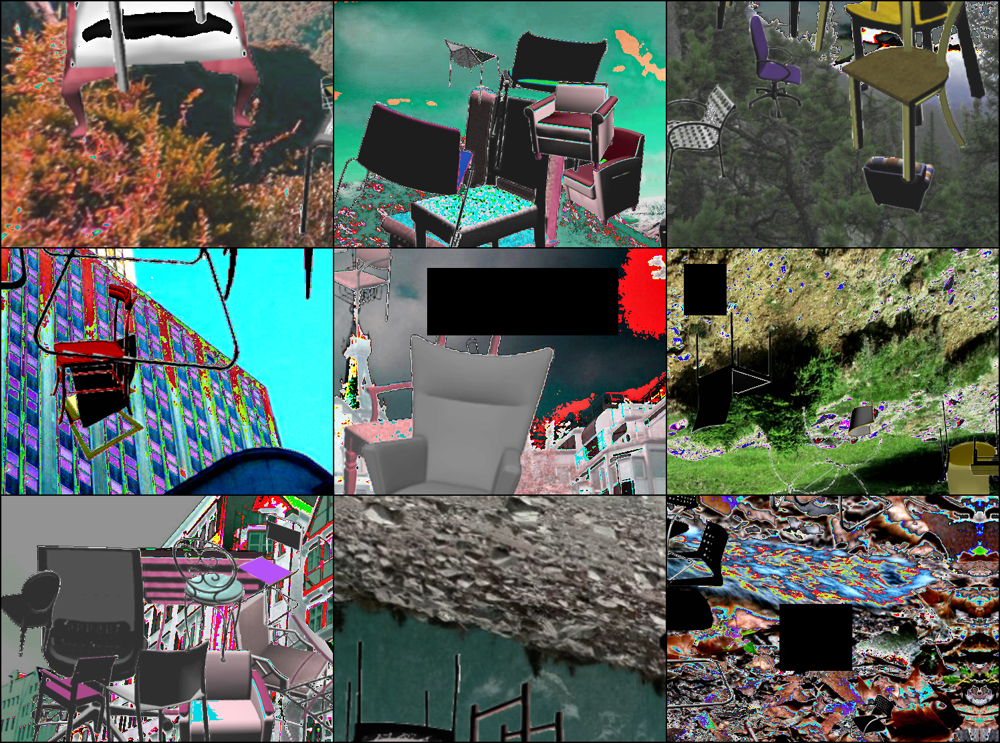

In [21]:
sampler = [flyingChairs[i][1] for i in indices]
grid = torchvision.utils.make_grid(sampler, nrow=3)
img = torchvision.transforms.ToPILImage()(grid)
img.show()